In [1]:
!pip install scikit-image einops opencv-python

# Task 4: Image Super Resolution with RRF features.

In [2]:
import torch
import torchvision
import matplotlib.pyplot as plt
import cv2

import numpy as np
import pandas as pd
import torch.nn as nn

# the gridspec module provides a flexible way to create complex grid layouts for arranging subplots in a figure.
import matplotlib.gridspec as gridspec
from sklearn.preprocessing import MinMaxScaler
import os

# Remove all the warnings
import warnings
warnings.filterwarnings('ignore')

# Set env CUDA_LAUNCH_BLOCKING=1
# os.environ['CUDA_LAUNCH_BLOCKING'] = '1': This line sets an 
# environment variable that makes CUDA operations synchronous.
#  Specifically, it ensures that all CUDA kernels 
# (operations executed on the GPU) are completed before moving 
# on to the next line of code. This is the effect of setting 
# CUDA_LAUNCH_BLOCKING to 1.

import os
os.environ['CUDA_LAUNCH_BLOCKING'] = '1'
if torch.cuda.is_available():
    device = 'cuda'
else:
    device = 'cpu'

# Retina display
%config InlineBackend.figure_format = 'retina'

# einops is a Python library that provides a concise and readable 
# way to perform complex tensor operations, such as reshaping, rearranging, and reducing dimensions.
try:
    from einops import rearrange
except ImportError:
    %pip install einops
    from einops import rearrange

In [3]:
# Downloading the image file
import os

url = 'https://segment-anything.com/assets/gallery/AdobeStock_94274587_welsh_corgi_pembroke_CD.jpg'
file_name = 'img.jpg'

# Check if the file already exists
if os.path.exists(file_name):
    print(f'{file_name} already exists')
else:
    # Use wget to download the file
    os.system(f'wget {url} -O {file_name}')
    print(f'{file_name} downloaded')


img.jpg already exists


In [4]:
# Downloading the image file using urllib
import os
import urllib.request

url = 'https://segment-anything.com/assets/gallery/AdobeStock_94274587_welsh_corgi_pembroke_CD.jpg'
file_name = 'img.jpg'

# Check if the file already exists
if os.path.exists(file_name):
    print(f'{file_name} already exists')
else:
    # Download the file using urllib
    urllib.request.urlretrieve(url, file_name)
    print(f'{file_name} downloaded')


img.jpg already exists


In [5]:
def processImg(img_url,filename,scale,coords = [600,800],showimg = False):
    
    # Check if the file already exists
    if os.path.exists(filename):
        print(f'{filename} already exists')
    else:
        # Use wget to download the file
        os.system(f'wget {img_url} -O {filename}')
        print(f'{filename} downloaded')
        

    img = torchvision.io.read_image(filename)
    
    if showimg == True:
        plt.imshow(rearrange(img,'c h w -> h w c'))
        plt.show()

    scaler_img = MinMaxScaler().fit(img.reshape(-1, 1))

    img_scaled = scaler_img.transform(img.reshape(-1, 1)).reshape(img.shape)

    img_scaled = torch.tensor(img_scaled)

    img_scaled = img_scaled.to(device)

    crop = torchvision.transforms.functional.crop(img_scaled.cpu(), coords[0], coords[1], 200, 200)

    crop = crop.to(device)

    scaler = MinMaxScaler()
    img_scaled = scaler.fit_transform(crop.cpu().reshape(-1,1)).reshape(crop.shape)
    img_scaled = torch.tensor(img_scaled).to(device)

    img = crop.cpu().numpy()

    img = img.transpose(1, 2, 0)

    resized_img = cv2.resize(img, (200//scale, 200//scale))

    resized_tensor = torch.from_numpy(resized_img).permute(2, 0, 1)

    return crop,resized_tensor

    


In [6]:
# Importing and processing the image using torch vision and cv2

img = torchvision.io.read_image('img.jpg')
print(img.shape)


torch.Size([3, 1365, 2048])


In [7]:
scaler_img = MinMaxScaler().fit(img.reshape(-1, 1))

img_scaled = scaler_img.transform(img.reshape(-1, 1)).reshape(img.shape)

display(img_scaled.shape)

img_scaled = torch.tensor(img_scaled)

img_scaled = img_scaled.to(device)

(3, 1365, 2048)

torch.Size([3, 400, 400])


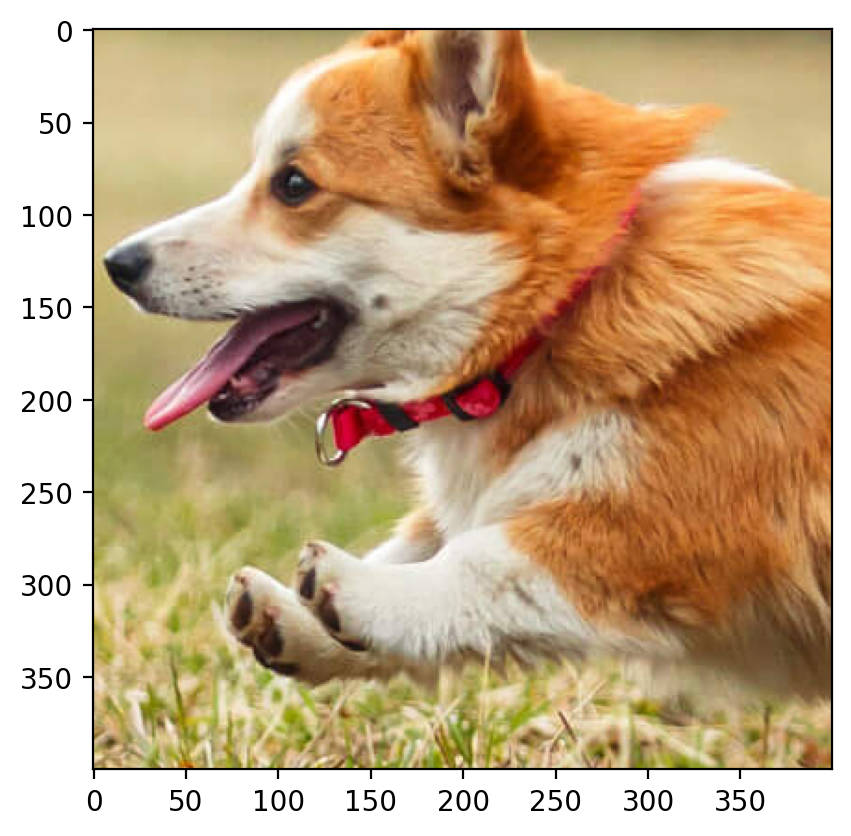

In [8]:
crop = torchvision.transforms.functional.crop(img_scaled.cpu(), 600, 800, 400, 400)
print(crop.shape)
plt.imshow(rearrange(crop, 'c h w -> h w c').cpu().numpy())
crop = crop.to(device)

Shape of scaled Image torch.Size([3, 400, 400])


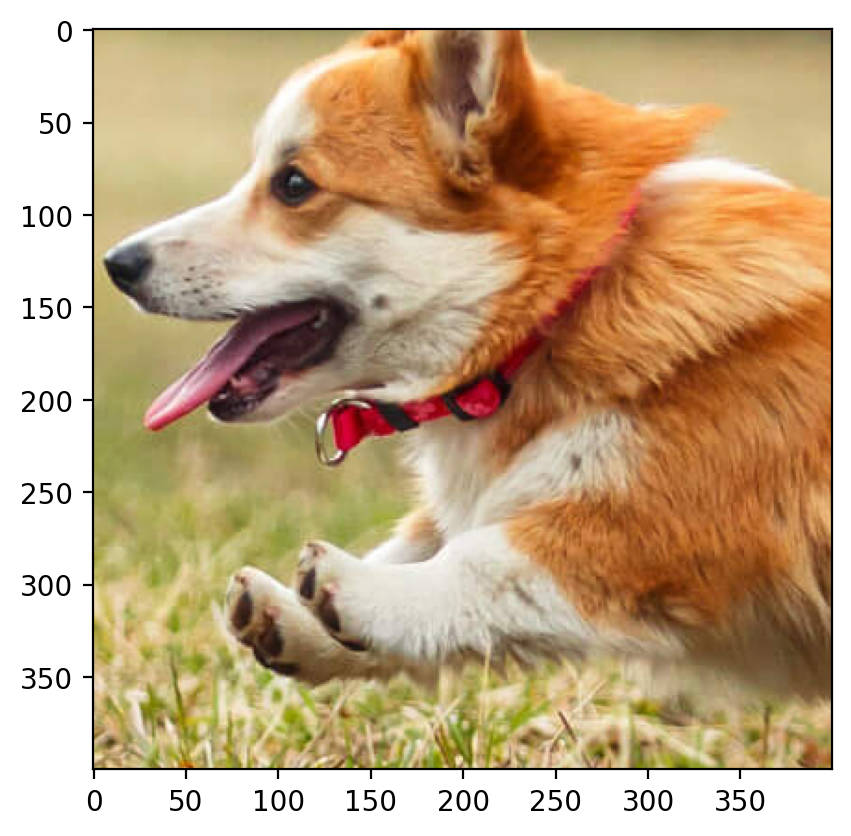

In [9]:
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
img_scaled = scaler.fit_transform(crop.cpu().reshape(-1,1)).reshape(crop.shape)
img_scaled = torch.tensor(img_scaled).to(device)
print("Shape of scaled Image",img_scaled.shape)
plt.imshow(rearrange(img_scaled.cpu(), 'c h w -> h w c').cpu().numpy())

torch.Size([3, 200, 200])


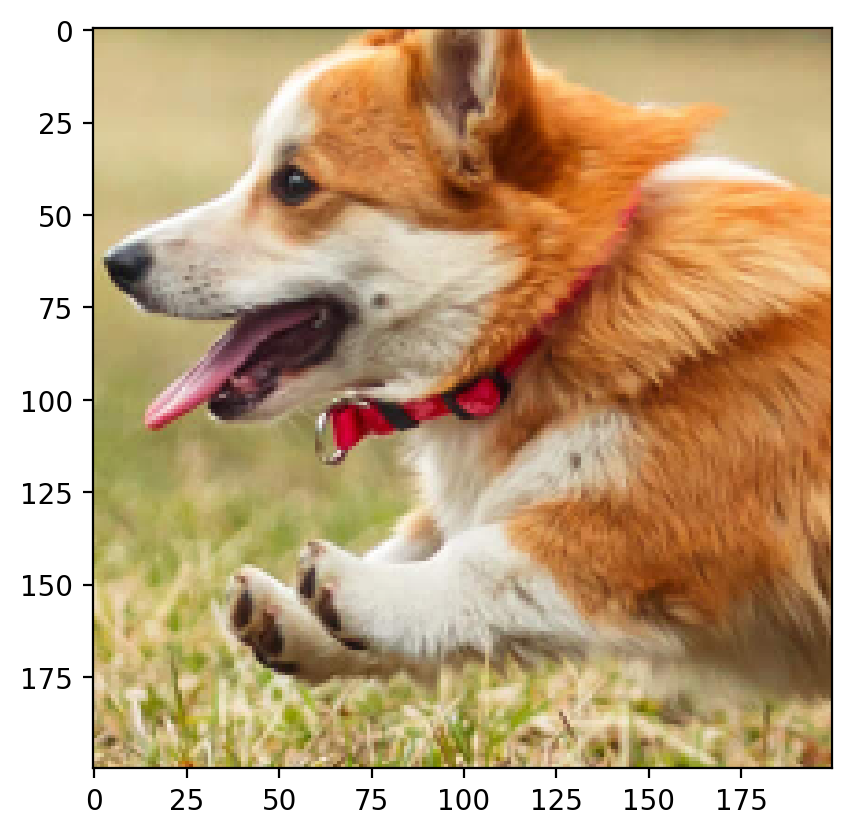

In [10]:
img = crop.cpu().numpy()

img = img.transpose(1, 2, 0)

resized_img = cv2.resize(img, (200, 200))

plt.imshow(resized_img)

resized_tensor = torch.from_numpy(resized_img).permute(2, 0, 1)

print(resized_tensor.shape) 


## Que: 1 
Super-resolution: Perform superresolution on the image shown in notebook to enhance its resolution by factor 2. Show a qualitative comparison of original and reconstructed image. (i.e display original image and the image you created side by side)

In [11]:
def train(net, lr, X, Y, epochs, device='cuda', verbose=True):

    criterion = nn.MSELoss()
    optimizer = torch.optim.Adam(net.parameters(), lr=lr)

    # Ensuring that all the tensors are on same device
    X = X.to(device)
    Y = Y.to(device)
    net = net.to(device)

    for epoch in range(epochs):
        optimizer.zero_grad()
        outputs = net(X)

        loss = criterion(outputs, Y)
        loss.backward()
        optimizer.step()

        if verbose and epoch % 100 == 0:
            print(f"Epoch {epoch} loss: {loss.item():.6f}")
    
    return loss.item()


In [12]:
from sklearn.kernel_approximation import RBFSampler

def create_rff_features(X, num_features, sigma):
    rff = RBFSampler(n_components=num_features, gamma=1/(2 * sigma**2),random_state = 42)
    X = X.cpu().numpy()
    X = rff.fit_transform(X)
    return torch.tensor(X, dtype=torch.float32).to(device)


In [13]:
def create_coordinate_map(img, scale=1):

    num_channels, height, width = img.shape

    # Create a 2D grid of (x,y) coordinates (h, w)
    # width values change faster than height values
    w_coords = torch.arange(0, width,  1/scale).repeat(int(height*scale), 1)
    h_coords = torch.arange(0, height, 1/scale).repeat(int(width*scale), 1).t()
    w_coords = w_coords.reshape(-1)
    h_coords = h_coords.reshape(-1)

    # Combine the x and y coordinates into a single tensor
    X = torch.stack([h_coords, w_coords], dim=1).float()

    # Move X to GPU if available
    X = X.to(device)

    # Reshape the image to (h * w, num_channels)
    Y = rearrange(img, 'c h w -> (h w) c').float()
    return X, Y

In [15]:
def plot_reconstructed_and_original_image(original_img, net, X,scale, title=""):
    """
    Function to plot the reconstructed image (output of a neural network) alongside the original image.

    Parameters:
    original_img: torch.Tensor
        The original image tensor of shape (num_channels, height, width).
    net: torch.nn.Module
        The trained neural network model used to reconstruct the image.
    X: torch.Tensor
        Input tensor to the network of shape (num_samples, in_features).
    title: str, optional (default="")
        Title for the entire figure.
    """

    # Extract the dimensions of the original image (number of channels, height, and width)
    num_channels, height, width = original_img.shape

    # Set the model to evaluation mode; this turns off dropout and batch normalization layers if present
    net.eval()

    # Temporarily disable gradient calculation to speed up computation and reduce memory usage
    with torch.no_grad():
        # Get the reconstructed output from the model by passing input tensor X
        outputs = net(X)

        # Reshape the output to match the original image dimensions (height, width, num_channels)
        outputs = outputs.reshape(scale*height, scale*width, num_channels)
        # outputs = outputs.permute(1, 2, 0)  # Uncomment if you need to change the channel order for visualization

    # Create a new figure with a specific size
    fig = plt.figure(figsize=(10, 6))

    # Create a GridSpec layout to place subplots in a grid; here, it's a 1x2 grid with equal width ratios
    gs = gridspec.GridSpec(1, 2, width_ratios=[1, 1])
    # display(gs)

    # Define the subplots within the GridSpec layout
    ax0 = plt.subplot(gs[0])
    ax1 = plt.subplot(gs[1])

    # Display the reconstructed image in the first subplot (ax0)
    # .cpu() moves the tensor to CPU if it's on GPU, which is necessary for matplotlib
    ax0.imshow(outputs.cpu())
    ax0.set_title("Upscaled Image")  # Set the title for the first subplot

    # Display the original image in the second subplot (ax1)
    # .permute(1, 2, 0) changes the channel order to (height, width, num_channels) for proper visualization in matplotlib
    ax1.imshow(original_img.cpu().permute(1, 2, 0))
    ax1.set_title("Blurr Image")  # Set the title for the second subplot

    # Turn off the axes for both subplots to improve visualization
    for a in [ax0, ax1]:
        a.axis("off")

    # Set a super title for the entire figure and adjust the layout to minimize overlap
    fig.suptitle(title, y=0.9)
    plt.tight_layout()
    
    return outputs



In [16]:
class LinearModel(nn.Module):
    def __init__(self, in_features, out_features):
        super(LinearModel, self).__init__()
        self.linear = nn.Linear(in_features, out_features)

    def forward(self, x):
        return self.linear(x)


In [17]:
import torch.nn.functional as F

# Define a ComplexModel class that inherits from nn.Module
class ComplexModel(nn.Module):
    def __init__(self, in_features, out_features, hidden_units=128, num_layers=4):
        super(ComplexModel, self).__init__()
        
        # Define the input layer
        self.input_layer = nn.Linear(in_features, hidden_units)
        
        # Define hidden layers
        self.hidden_layers = nn.ModuleList([
            nn.Linear(hidden_units, hidden_units) for _ in range(num_layers)
        ])
        
        # Define the output layer
        self.output_layer = nn.Linear(hidden_units, out_features)
    
    def forward(self, x):
        # Pass through the input layer and apply ReLU activation
        x = F.relu(self.input_layer(x))
        
        # Pass through each hidden layer with ReLU activation
        for layer in self.hidden_layers:
            x = F.relu(layer(x))
        
        # Pass through the output layer (no activation here)
        x = self.output_layer(x)
        
        return x


In [18]:
n_features = 40000
sigma = 0.01

In [19]:
X_resized, Y_resized = create_coordinate_map(resized_tensor, scale=1)

scaler_X = MinMaxScaler(feature_range=(-1, 1)).fit(X_resized.cpu())

X_scaled = scaler_X.transform(X_resized.cpu())

X_scaled = torch.tensor(X_scaled).to(device)

X_scaled = X_scaled.float()

X_rff = create_rff_features(X_scaled, n_features, sigma)

print(X_rff.shape)
print(X_scaled.shape)

net = LinearModel(X_rff.shape[1], 3)
net.to(device)

train(net, 0.005, X_rff, Y_resized, 2500, device)

# Saving the model
torch.save(net.state_dict(),'linear_model_dog.pth')

torch.Size([40000, 40000])
torch.Size([40000, 2])
Epoch 0 loss: 0.367948
Epoch 100 loss: 0.036669
Epoch 200 loss: 0.004087
Epoch 300 loss: 0.001137
Epoch 400 loss: 0.000591
Epoch 500 loss: 0.000421
Epoch 600 loss: 0.000358
Epoch 700 loss: 0.000333
Epoch 800 loss: 0.000321
Epoch 900 loss: 0.000316
Epoch 1000 loss: 0.000313
Epoch 1100 loss: 0.000311
Epoch 1200 loss: 0.000309
Epoch 1300 loss: 0.000308
Epoch 1400 loss: 0.000307
Epoch 1500 loss: 0.000306
Epoch 1600 loss: 0.000305
Epoch 1700 loss: 0.000304
Epoch 1800 loss: 0.000304
Epoch 1900 loss: 0.000303
Epoch 2000 loss: 0.000303
Epoch 2100 loss: 0.000302
Epoch 2200 loss: 0.000302
Epoch 2300 loss: 0.000302
Epoch 2400 loss: 0.000301


In [20]:
from sklearn import preprocessing
import torch

# Define the scale factor
scale = 2

# Create coordinate map with resized tensor
X, Y = create_coordinate_map(resized_tensor, scale)

# MinMaxScaler to scale from -1 to 1
scaler_X = preprocessing.MinMaxScaler(feature_range=(-1, 1)).fit(X.cpu())

# Scale the X coordinates
X_scaled = scaler_X.transform(X.cpu())

# Move the scaled X coordinates to the GPU
X_scaled = torch.tensor(X_scaled).to(device)

# Set dtype to float32
X_scaled = X_scaled.float()

# Generate RFF features from the scaled X coordinates
X_rff_new = create_rff_features(X_scaled, n_features, sigma)

# Print information for debugging
print("X_scaled:")
print(X_scaled)
print("X_rff_new:")
print(X_rff_new)
print("X_rff_new shape:")
print(X_rff_new.shape)
print("X_rff:")
print(X_rff)


X_scaled:
tensor([[-1.0000, -1.0000],
        [-1.0000, -0.9950],
        [-1.0000, -0.9900],
        ...,
        [ 1.0000,  0.9900],
        [ 1.0000,  0.9950],
        [ 1.0000,  1.0000]], device='cuda:0')
X_rff_new:
tensor([[ 0.0063,  0.0070,  0.0052,  ...,  0.0056,  0.0070, -0.0025],
        [ 0.0054,  0.0065,  0.0047,  ...,  0.0064,  0.0070, -0.0054],
        [ 0.0042,  0.0043,  0.0042,  ...,  0.0069,  0.0070, -0.0069],
        ...,
        [ 0.0019, -0.0040,  0.0012,  ...,  0.0050,  0.0040, -0.0066],
        [ 0.0002, -0.0006,  0.0019,  ...,  0.0038,  0.0040, -0.0070],
        [-0.0014,  0.0029,  0.0026,  ...,  0.0023,  0.0040, -0.0057]],
       device='cuda:0')
X_rff_new shape:
torch.Size([160000, 40000])
X_rff:
tensor([[ 0.0063,  0.0070,  0.0052,  ...,  0.0056,  0.0070, -0.0025],
        [ 0.0042,  0.0043,  0.0042,  ...,  0.0069,  0.0070, -0.0069],
        [ 0.0011, -0.0025,  0.0030,  ...,  0.0068,  0.0070, -0.0050],
        ...,
        [ 0.0048, -0.0071, -0.0002,  ...,  0.00

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


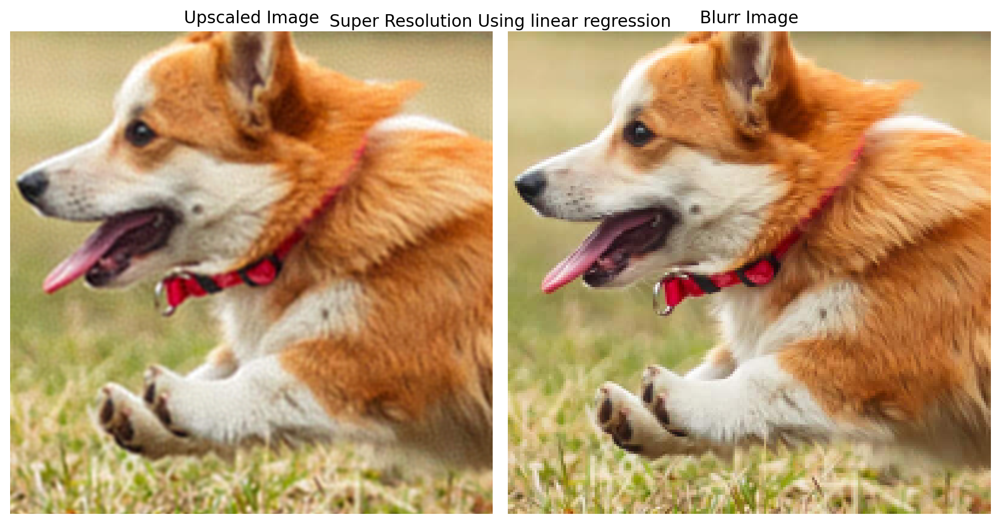

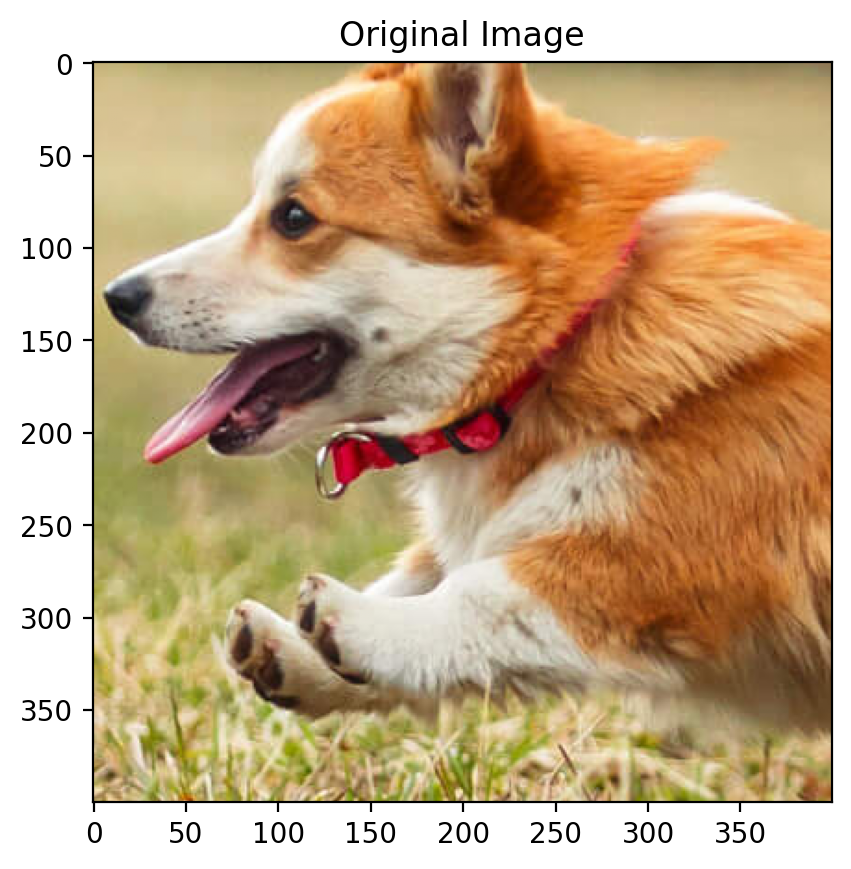

In [21]:
img_linear = plot_reconstructed_and_original_image(resized_tensor, net, X_rff_new,scale ,title="Super Resolution Using linear regression")
plt.figure()
plt.title("Original Image")
plt.imshow(rearrange(img_scaled.cpu(), 'c h w -> h w c').cpu().numpy())
# img_complex = plot_reconstructed_and_original_image(resized_tensor, comp, X_rff_new,scale ,title="Super Resolution Using Neural Network")
# plt.imshow(crop)
plt.show()
del X_rff_new
del X_rff

## Que 2:

The above only helps us with a qualitative comparison. Let us now do a quantitative comparison. Compute the below given metrics: [1 Marks]
RMSE on predicted v/s ground truth high resolution image
Peak SNR on predicted v/s ground truth high resolution image

In [27]:
crop = rearrange(img_scaled.cpu(), 'c h w -> h w c').cpu()

def rmse(original,predicted):

    predicted = predicted.cpu().float()
    ground_truth = original.cpu().float()

    # Compute RMSE
    mse = torch.mean((predicted - ground_truth) ** 2)
    rmse = torch.sqrt(mse)
    
    return rmse.item()

print("RMSE for the upscaled image",rmse(crop,img_linear))

RMSE for the upscaled image 0.02767573669552803


In [28]:
# manually applying the psnr function
def implemented_psnr(img1, img2):

    img1 = img1.to(device)
    img2 = img2.to(device)

    # Calculate the Mean Squared Error (MSE)
    mse = torch.mean((img1 - img2) ** 2)
    
    if mse == 0:
        # MSE is zero means no difference between the images
        return float('inf')

    # Max pixel value is 1 because we have scaled it using min max scaler
    
    max_pixel_value = 1
    psnr_value = 20 * torch.log10(torch.tensor(max_pixel_value) / torch.sqrt(mse))
    
    return psnr_value.item()  # Convert tensor to a Python float for printing


# Using the skimage.metrics.peak_signal_noise_ratio
from skimage.metrics import peak_signal_noise_ratio as psnr
def calculate_psnr(img1, img2):
    
    img1 = img1.detach().cpu().numpy()
    
    img2 = img2.detach().cpu().numpy()

    psnr_value = psnr(img1, img2, data_range=1)

    return psnr_value.item()



# Higher the psnr the better

print("PSNR for the upscaled image by implemented function",implemented_psnr(crop,img_linear))
print("PSNR for the upscaled image by skimage psnr function",calculate_psnr(crop,img_linear))

PSNR for the upscaled image by implemented function 31.158016893286145
PSNR for the upscaled image by skimage psnr function 31.15801689328615


### Model is saved for dog.jpg 
*Loading the saved Model*

n_features = 30000
sigma = 0.025

In [30]:
from sklearn import preprocessing
n_features = 40000
sigma = 0.01
scale = 2
url = "https://segment-anything.com/assets/gallery/AdobeStock_94274587_welsh_corgi_pembroke_CD.jpg"

device = 'cuda' if torch.cuda.is_available() else 'cpu'
net = LinearModel(n_features, 3)
net.to(device) 
saved_dict = torch.load('linear_model_dog.pth', map_location=device)
net.load_state_dict(saved_dict)

crop , resized_tensor = processImg(url,'dog.jpg',scale)

# Define the scale factor

# Create coordinate map with resized tensor
X, Y = create_coordinate_map(resized_tensor, scale)

# MinMaxScaler to scale from -1 to 1
scaler_X = preprocessing.MinMaxScaler(feature_range=(-1, 1)).fit(X.cpu())

# Scale the X coordinates
X_scaled = scaler_X.transform(X.cpu())

# Move the scaled X coordinates to the GPU
X_scaled = torch.tensor(X_scaled).to(device)

# Set dtype to float32
X_scaled = X_scaled.float()

# Generate RFF features from the scaled X coordinates
X_rff_new = create_rff_features(X_scaled, n_features, sigma)

img_upscaled = net(X_rff_new)

img_upscaled.shape



--2024-09-16 11:02:40--  https://segment-anything.com/assets/gallery/AdobeStock_94274587_welsh_corgi_pembroke_CD.jpg
Resolving segment-anything.com (segment-anything.com)... 3.162.125.110, 3.162.125.66, 3.162.125.35, ...
Connecting to segment-anything.com (segment-anything.com)|3.162.125.110|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 221810 (217K) [image/jpeg]
Saving to: ‘dog.jpg’

     0K .......... .......... .......... .......... .......... 23% 43.7M 0s
    50K .......... .......... .......... .......... .......... 46% 69.0M 0s
   100K .......... .......... .......... .......... .......... 69% 73.5M 0s
   150K .......... .......... .......... .......... .......... 92%  135M 0s
   200K .......... ......                                     100% 91.0M=0.003s

2024-09-16 11:02:40 (69.8 MB/s) - ‘dog.jpg’ saved [221810/221810]



dog.jpg downloaded


torch.Size([40000, 3])

In [31]:
crop.shape

torch.Size([3, 200, 200])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Text(0.5, 1.0, 'Original Image')

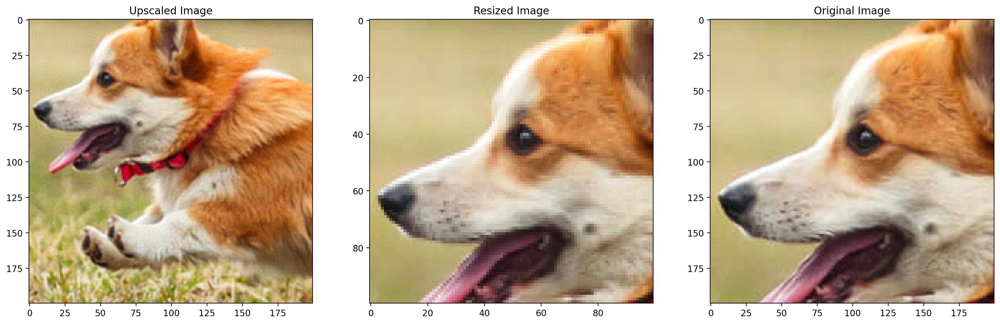

In [32]:
img = img_upscaled.reshape(200,200,3)

# Create a new figure with a specific size
fig = plt.figure(figsize=(20, 10))

# Create a GridSpec layout to place subplots in a grid; here, it's a 1x2 grid with equal width ratios
gs = gridspec.GridSpec(1, 3)
# display(gs)

# Define the subplots within the GridSpec layout
ax0 = plt.subplot(gs[0])
ax1 = plt.subplot(gs[1])
ax2 = plt.subplot(gs[2])

# Display the reconstructed image in the first subplot (ax0)
# .cpu() moves the tensor to CPU if it's on GPU, which is necessary for matplotlib
ax0.imshow(img.detach().cpu().numpy())
ax0.set_title("Upscaled Image")  # Set the title for the first subplot

# Display the original image in the second subplot (ax1)
# .permute(1, 2, 0) changes the channel order to (height, width, num_channels) for proper visualization in matplotlib
ax1.imshow(resized_tensor.cpu().permute(1, 2, 0))
ax1.set_title("Resized Image")  # Set the title for the second subplot

ax2.imshow(crop.cpu().permute(1,2,0))
ax2.set_title("Original Image")


# Observations

1) On increasing the value of sigma the fundamental frequency of the rrf features decreases. therefore the bias in the prediction increases and the overfitting decreases. In the following code we can observe that the image getting blurred with increasing the value of sigma.

2) The psnr value and rmse have inverse relation. Higher the psnr the better. In case of rmse lower value is preferred. Initially when sigma is very small the rmse is high and psnr is low indicating that there is distortion in image,which we know due to overfitting the model is unable to generalize well. As we increase the value of sigma the , rmse decreases and psnr increases which suggests that the upscaled image has less distortion. But further increasing the sigma leads to blurring of the image and rmse increases, psnr decreases. This depicts that at higher value of sigma the image has more distortion. Which we know due to high bias when the frequency factor gamma is low in RRF due to higher sigma , leads to blurring of the image.

3) We have also tried implementing the neural network for super resolution. We have used four relu activated hidden layers with output layer as regression layer. We concluded that the neural network performs very well in upscaling. It can even work well with 3000 features whereas in linear regression we have to provide 30000 features for precise results. And due to less number of features Neural Network turns out to be quicker than LinearRegression even though it has 4 hidden layers. Also less features are computationally cheap and memory efficient.

# Wrapping the code in a function

In [38]:
os.mkdir('images')

In [39]:
import torch
from sklearn.preprocessing import MinMaxScaler

def upscale(image_url,filename, model, scale,coords = [600,800],showimg = False, n_features=30000, sigma=0.03):

    img_original , blur_image = processImg(image_url,filename,scale,coords,showimg)
    
    blur_image = torch.tensor(blur_image).to(device)

    
    # Create coordinate map for the blurred image
    X_resized, Y_resized = create_coordinate_map(blur_image, 1)

    # MinMaxScaler to scale from -1 to 1
    scaler_X = MinMaxScaler(feature_range=(-1, 1)).fit(X_resized.cpu())

    # Scale the X coordinates
    X_scaled = scaler_X.transform(X_resized.cpu())

    # Move the scaled X coordinates to the GPU
    X_scaled = torch.tensor(X_scaled).to(device).float()

    # Generate RFF features from the scaled X coordinates
    X_rff = create_rff_features(X_scaled, n_features, sigma)

    # Initialize and move the model to the GPU
    net = model(X_rff.shape[1], 3).to(device)

    # Train the model
    print("***********************Patience Brings Prosperity*****************************")
    train(net, 0.005, X_rff, Y_resized, 2500, device,verbose=False)
    
    # Create coordinate map for the scaled image
    X_new, _ = create_coordinate_map(blur_image, scale)  # Assuming resized_tensor is the same as blur_image

    # Scale the X coordinates for the new image
    X_scaled_new = scaler_X.transform(X_new.cpu())
    X_scaled_new = torch.tensor(X_scaled_new).to(device).float()

    # Generate RFF features from the scaled X coordinates for the new image
    X_rff_new = create_rff_features(X_scaled_new, n_features, sigma)
    
    # Set the model to evaluation mode
    net.eval()

    # Temporarily disable gradient calculation to speed up computation and reduce memory usage
    with torch.no_grad():
        # Get the reconstructed output from the model
        outputs = net(X_rff_new)

        # Reshape the output to match the scaled image dimensions
        num_channels, height, width = blur_image.shape
        outputs = outputs.reshape(scale * height, scale * width, num_channels)

    # Create a new figure with a specific size
    fig = plt.figure(figsize=(20, 10))
    
    # Create a GridSpec layout to place subplots in a grid; here, it's a 1x2 grid with equal width ratios
    gs = gridspec.GridSpec(1, 3)
    # display(gs)

    # Define the subplots within the GridSpec layout
    ax0 = plt.subplot(gs[0])
    ax1 = plt.subplot(gs[1])
    ax2 = plt.subplot(gs[2])

    # Display the reconstructed image in the first subplot (ax0)
    # .cpu() moves the tensor to CPU if it's on GPU, which is necessary for matplotlib
    ax0.imshow(outputs.cpu())
    ax0.set_title("Upscaled Image")  # Set the title for the first subplot

    # Display the original image in the second subplot (ax1)
    # .permute(1, 2, 0) changes the channel order to (height, width, num_channels) for proper visualization in matplotlib
    ax1.imshow(blur_image.cpu().permute(1, 2, 0))
    ax1.set_title("Resized Image")  # Set the title for the second subplot
    
    ax2.imshow(rearrange(img_original,'c h w -> h w c').cpu())
    ax2.set_title("Original Image")

    # Turn off the axes for both subplots to improve visualization
    for a in [ax0, ax1,ax2]:
        a.axis("off")

    # Set a super title for the entire figure and adjust the layout to minimize overlap
    plt.savefig(f"./images/img_{round(sigma,3)}.jpg")
    fig.suptitle(filename, y=0.9)
    plt.tight_layout()
    plt.show()
    
#     print(outputs.shape)
#     print(img_original.shape)

    temp_rmse = rmse(rearrange(img_original.cpu(), 'c h w -> h w c').cpu(),outputs)
    temp_psnr = implemented_psnr(rearrange(img_original.cpu(), 'c h w -> h w c').cpu(),outputs)

    print("RMSE: ",temp_rmse)
    print("PSNR: ",temp_psnr)
    
    
    print("*"*60)
    print("\n\n\n\n\n")
    del X_rff_new
    del X_rff
    return outputs.cpu(),temp_rmse,temp_psnr


In [40]:
# del X_rff_new
# del X_rff

img1 already exists


***********************Patience Brings Prosperity*****************************


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


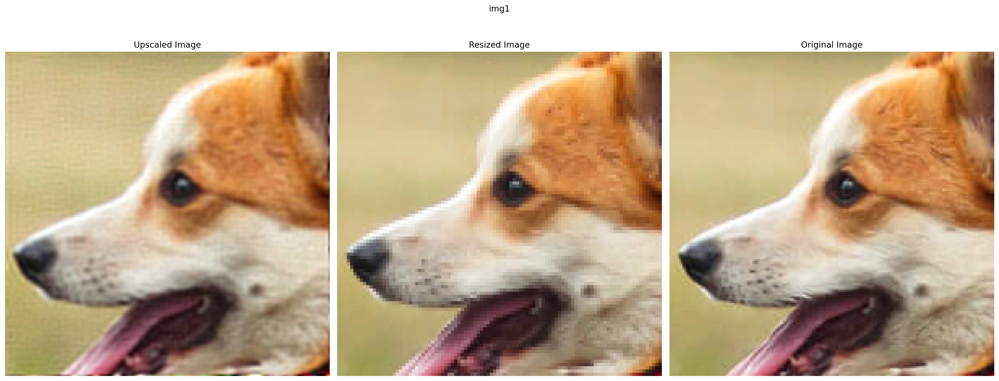

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


RMSE:  0.03347392752766609
PSNR:  29.5058669180048
************************************************************








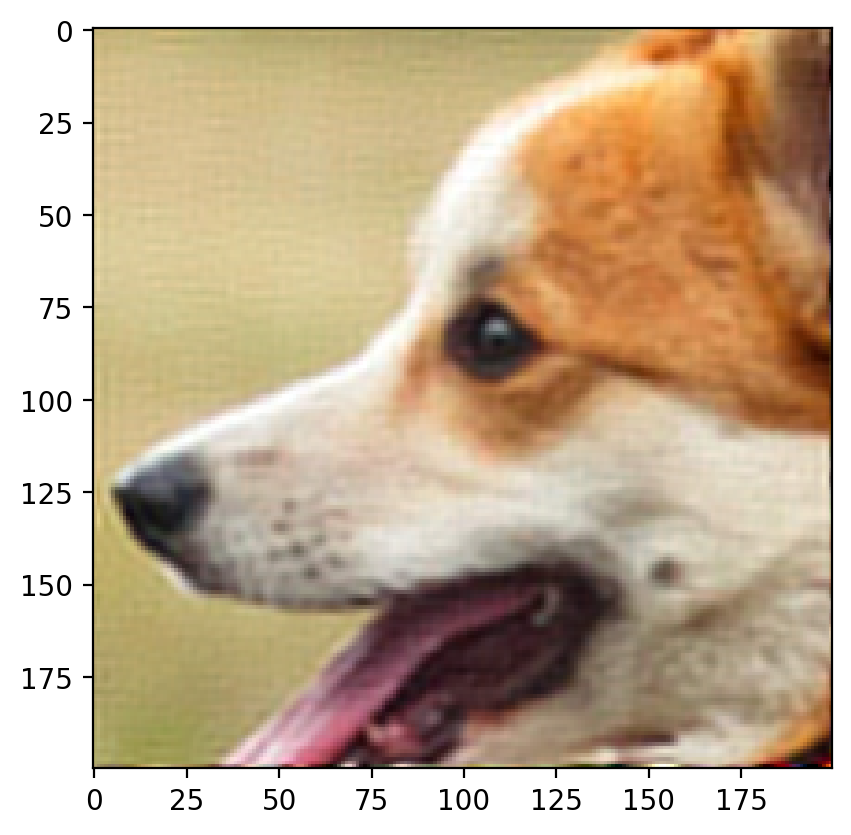

In [51]:
scale = 2
output,rmse_val,psnr_val = upscale(url,"img1",LinearModel,scale, n_features=30000, sigma=0.02)
plt.imshow(output)

### Comparing the results for different sigmas

In [50]:
import ipywidgets as widgets
import matplotlib.pyplot as plt
from IPython.display import display
import cv2

# Function to display different images for each slider value
def display_image(value):
    # Format the value to match the filename
    value = round(value,3)
    
    try:
        # Load and display the image
        img = cv2.cvtColor(cv2.imread(f'./images/img_{value}.jpg'), cv2.COLOR_BGR2RGB)
        plt.figure(figsize=(20,10))
        plt.title(f"Sigma: {value}")
        plt.imshow(img)
        plt.axis('off')
        plt.show()
    except Exception as e:
        print(f"Error: Could not load image for value {value}. Error: {e}")

# Create a slider that takes values from 0.005 to 0.01
slider = widgets.FloatSlider(
    value=0.005,
    min=0.005,
    max=0.1,
    step=0.005,
    description='Sigma:',
    readout_format='.4f'
)

# Use an interactive display to update the image when the slider is changed
widgets.interact(display_image, value=slider)

# Display the slider
# display(slider)


interactive(children=(FloatSlider(value=0.005, description='Sigma:', max=0.1, min=0.005, readout_format='.4f',…

<function __main__.display_image(value)>

Sigma =  0.005
img1 already exists


***********************Patience Brings Prosperity*****************************


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


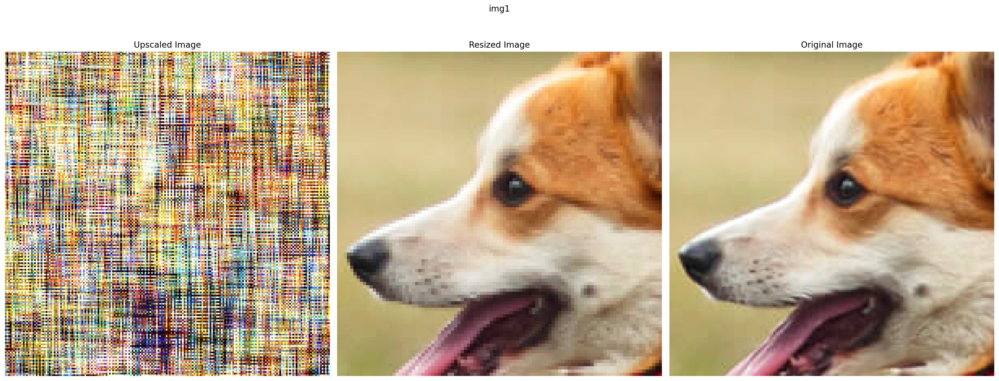

RMSE:  0.38800323009490967
PSNR:  8.22329431229473
************************************************************






Sigma =  0.01
img1 already exists
***********************Patience Brings Prosperity*****************************


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


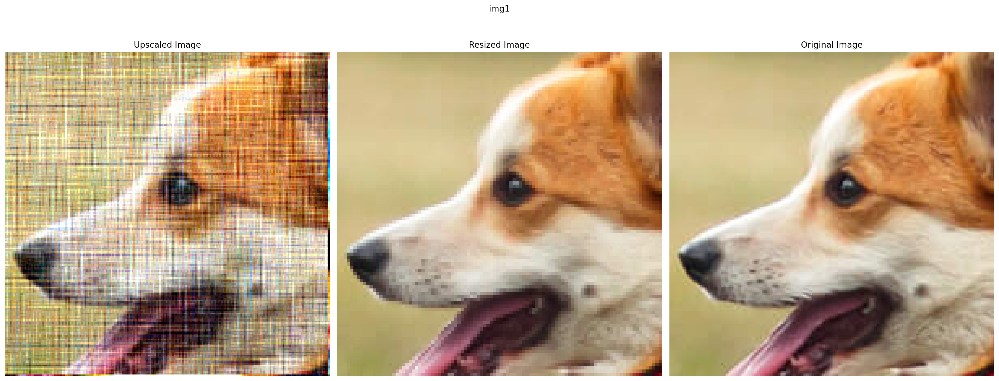

RMSE:  0.13989777863025665
PSNR:  17.08378367543275
************************************************************






Sigma =  0.015
img1 already exists
***********************Patience Brings Prosperity*****************************


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


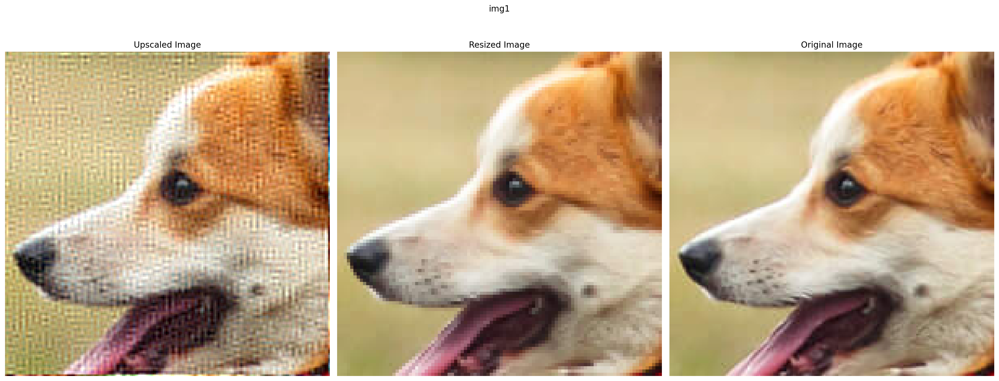

RMSE:  0.07445067167282104
PSNR:  22.562627442435556
************************************************************






Sigma =  0.02
img1 already exists
***********************Patience Brings Prosperity*****************************


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


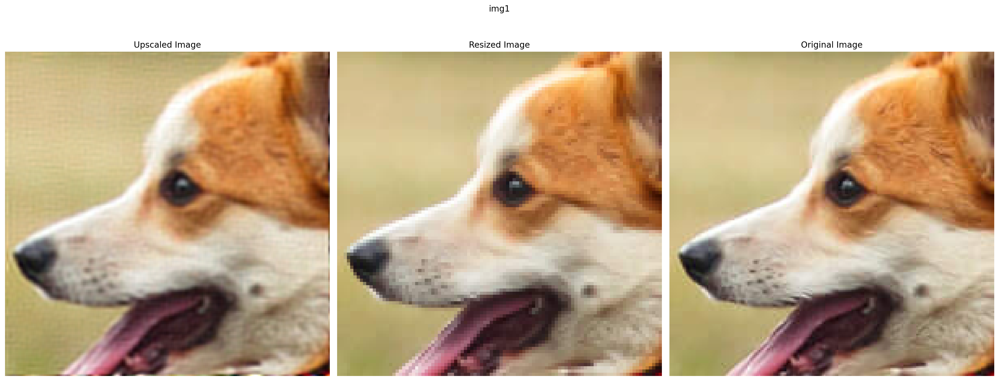

RMSE:  0.03347478434443474
PSNR:  29.505644680809095
************************************************************






Sigma =  0.025
img1 already exists
***********************Patience Brings Prosperity*****************************


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


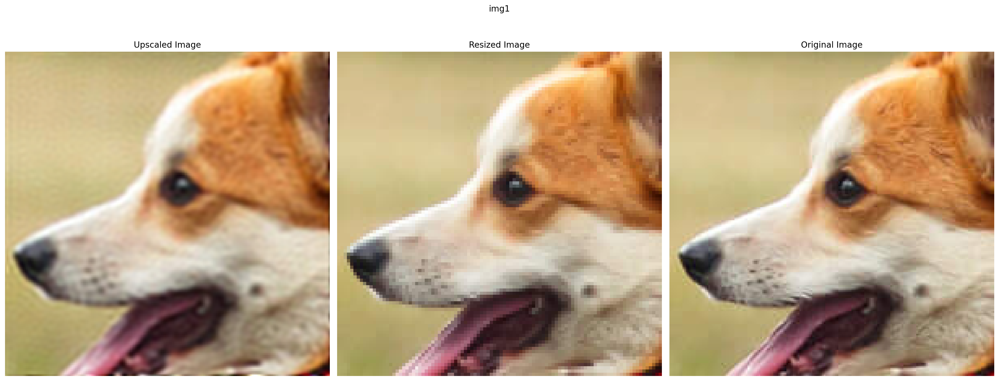

RMSE:  0.03211424872279167
PSNR:  29.866045260208747
************************************************************






Sigma =  0.030000000000000002
img1 already exists
***********************Patience Brings Prosperity*****************************


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


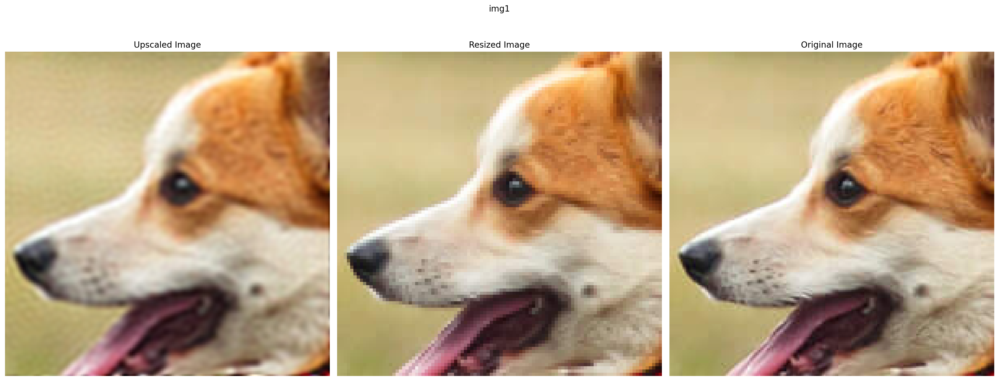

RMSE:  0.032613229006528854
PSNR:  29.73212362486782
************************************************************






Sigma =  0.034999999999999996
img1 already exists
***********************Patience Brings Prosperity*****************************


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


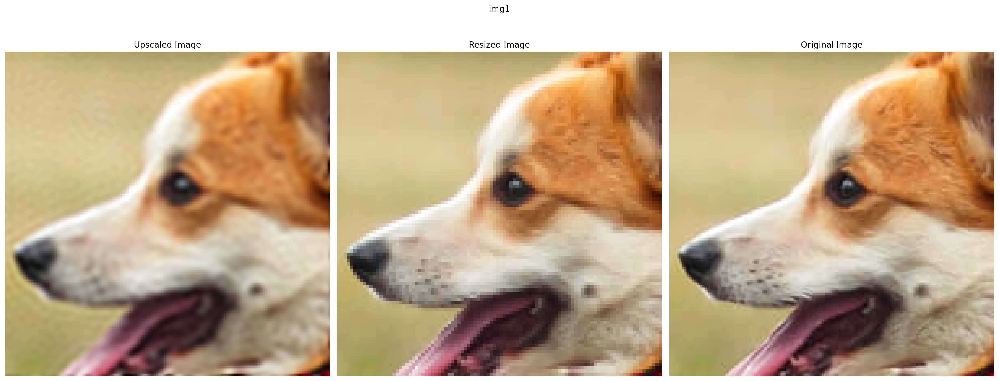

RMSE:  0.03343241289258003
PSNR:  29.516645782321515
************************************************************






Sigma =  0.04
img1 already exists
***********************Patience Brings Prosperity*****************************


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


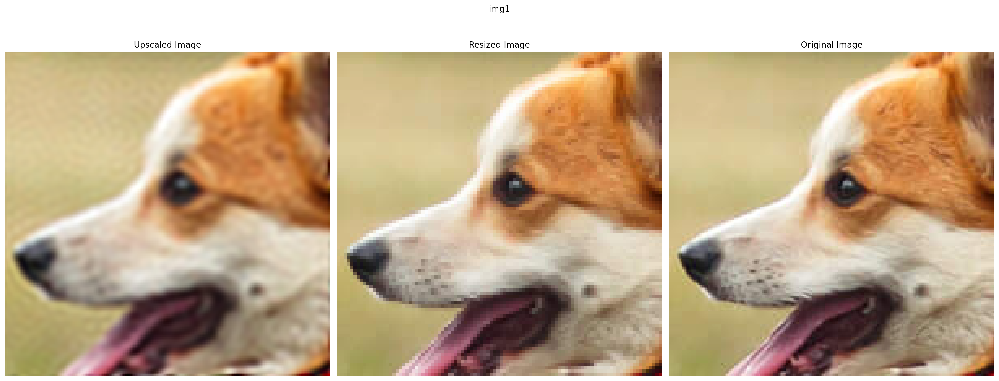

RMSE:  0.03481950983405113
PSNR:  29.1635464250243
************************************************************






Sigma =  0.045
img1 already exists
***********************Patience Brings Prosperity*****************************


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


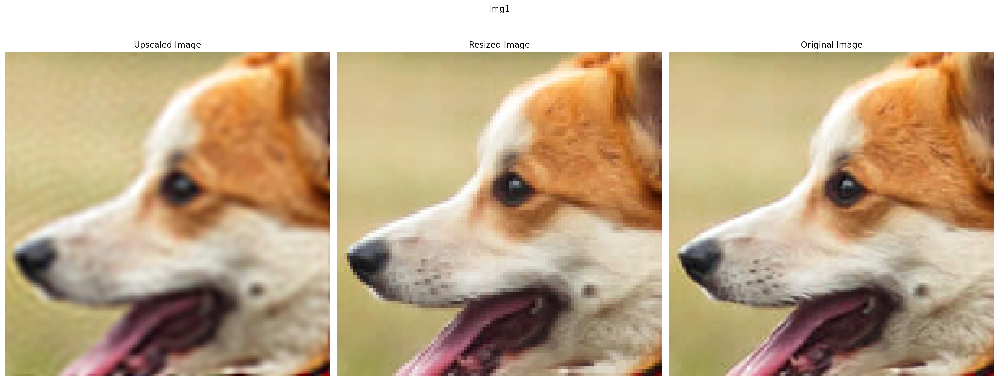

RMSE:  0.035952381789684296
PSNR:  28.885446967102524
************************************************************






Sigma =  0.049999999999999996
img1 already exists
***********************Patience Brings Prosperity*****************************


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


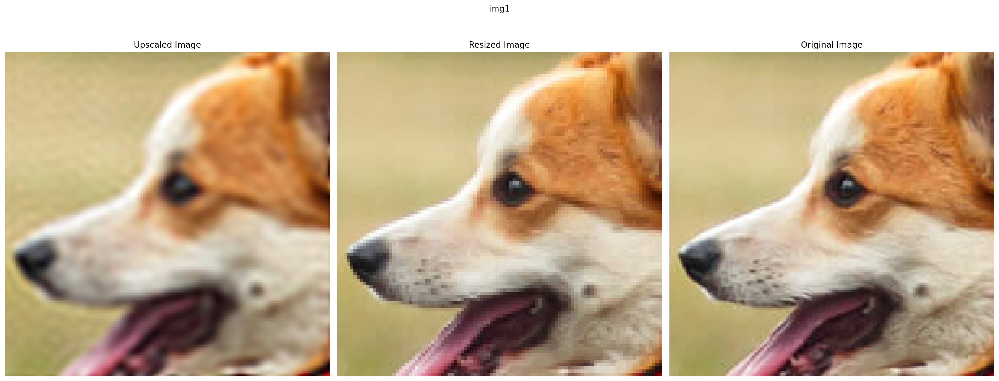

RMSE:  0.03712162375450134
PSNR:  28.607460659227414
************************************************************






Sigma =  0.055
img1 already exists
***********************Patience Brings Prosperity*****************************


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


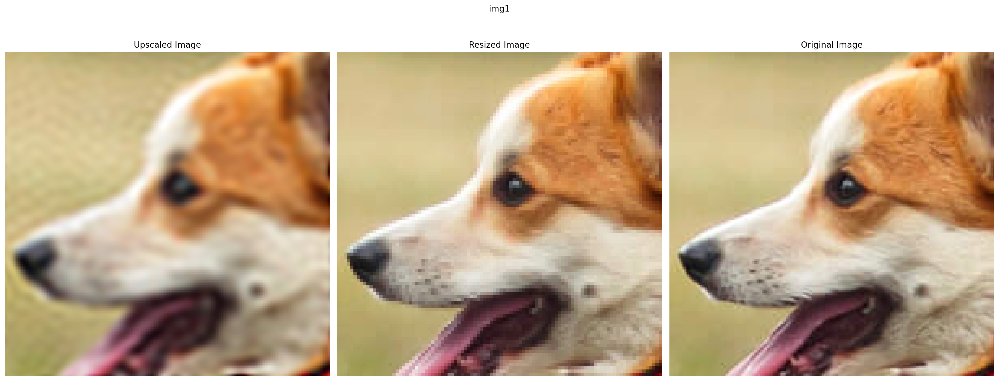

RMSE:  0.03835345804691315
PSNR:  28.32390982230439
************************************************************






Sigma =  0.06
img1 already exists
***********************Patience Brings Prosperity*****************************


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


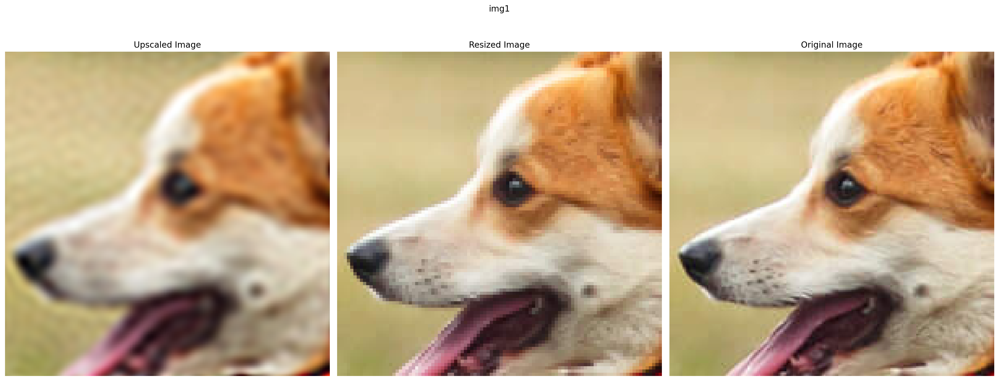

RMSE:  0.039677686989307404
PSNR:  28.029073275227514
************************************************************






Sigma =  0.065
img1 already exists
***********************Patience Brings Prosperity*****************************


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


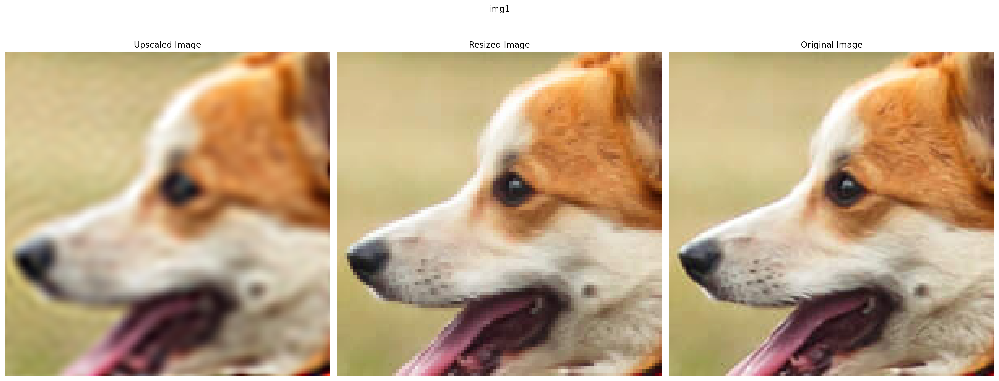

RMSE:  0.041128721088171005
PSNR:  27.71709569864464
************************************************************






Sigma =  0.07
img1 already exists
***********************Patience Brings Prosperity*****************************


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


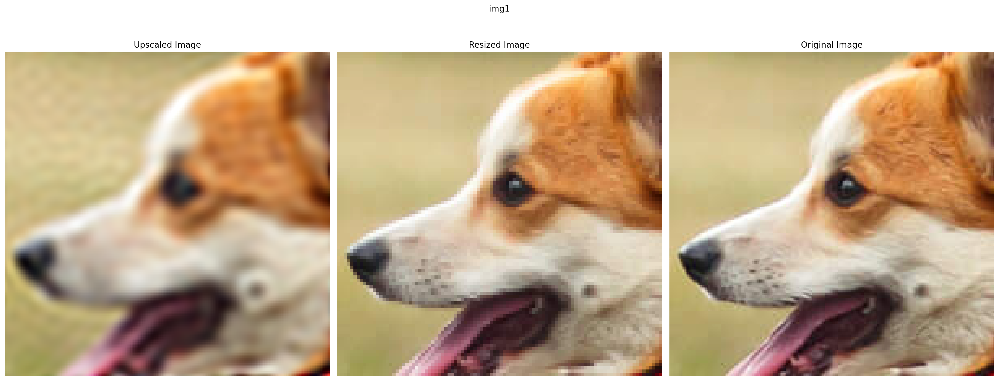

RMSE:  0.04239917919039726
PSNR:  27.452851017268102
************************************************************






Sigma =  0.07500000000000001
img1 already exists
***********************Patience Brings Prosperity*****************************


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


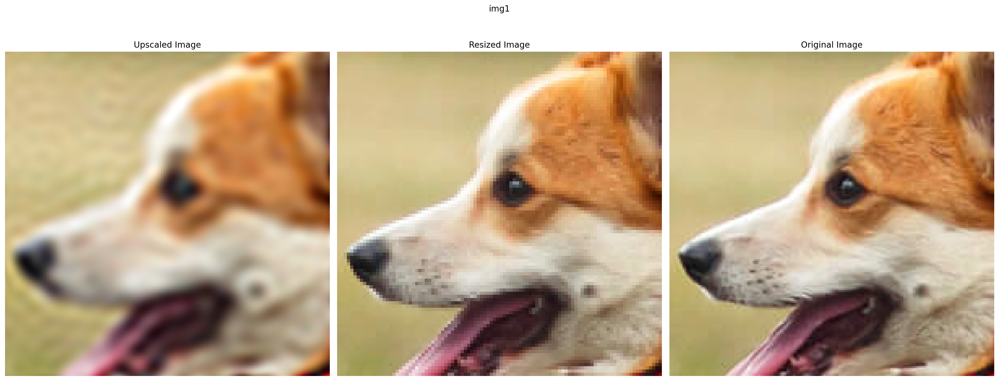

RMSE:  0.043455298990011215
PSNR:  27.239145325237413
************************************************************






Sigma =  0.08
img1 already exists
***********************Patience Brings Prosperity*****************************


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


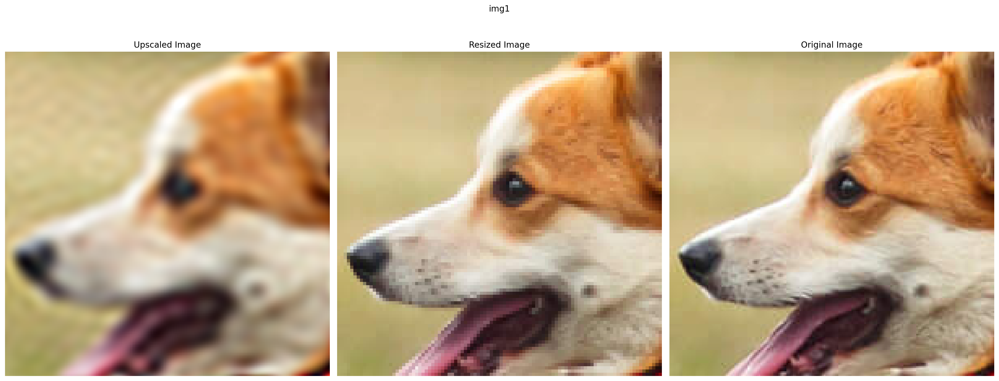

RMSE:  0.04458184912800789
PSNR:  27.016838477671957
************************************************************






Sigma =  0.085
img1 already exists
***********************Patience Brings Prosperity*****************************


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


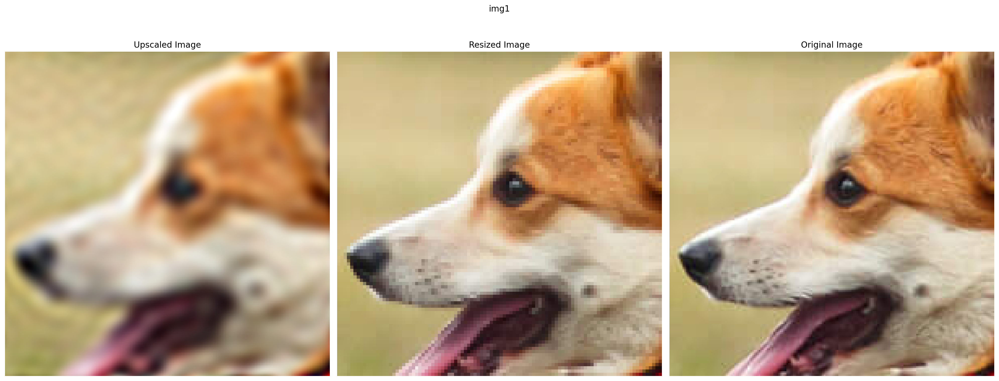

RMSE:  0.04606013745069504
PSNR:  26.733496489089966
************************************************************






Sigma =  0.09000000000000001
img1 already exists
***********************Patience Brings Prosperity*****************************


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


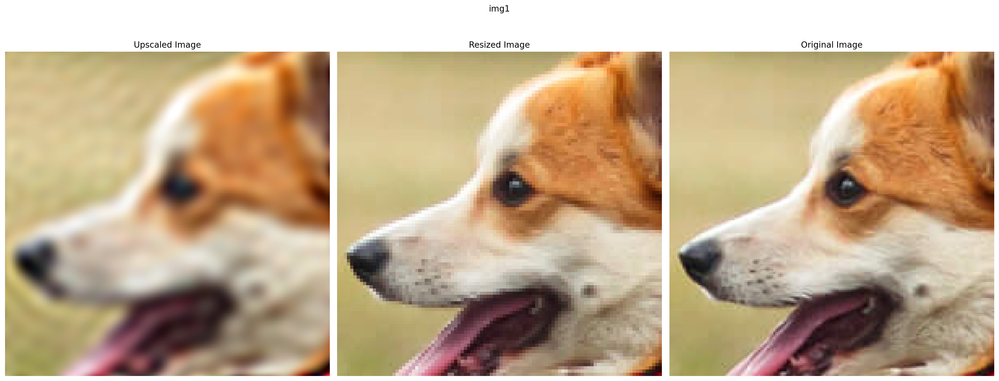

RMSE:  0.047036830335855484
PSNR:  26.55123906749081
************************************************************






Sigma =  0.095
img1 already exists
***********************Patience Brings Prosperity*****************************


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


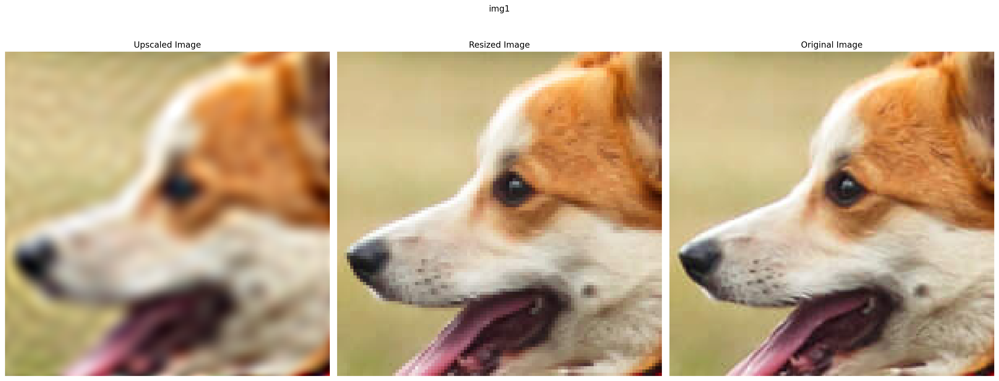

RMSE:  0.048717424273490906
PSNR:  26.246313251220748
************************************************************






Sigma =  0.1
img1 already exists
***********************Patience Brings Prosperity*****************************


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


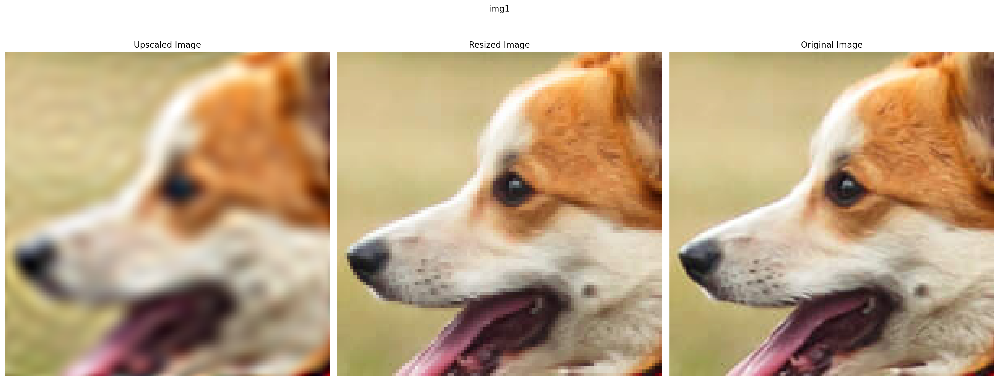

RMSE:  0.04993608966469765
PSNR:  26.031709132179607
************************************************************






Sigma =  0.10500000000000001
img1 already exists
***********************Patience Brings Prosperity*****************************


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


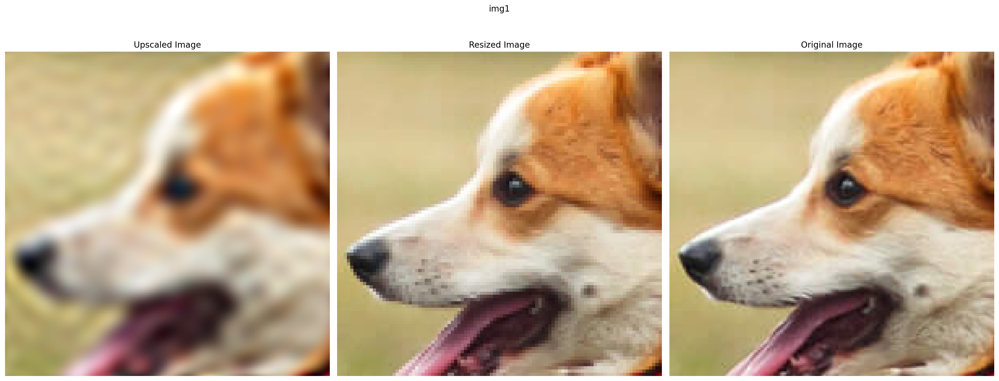

RMSE:  0.05110587179660797
PSNR:  25.830585002287123
************************************************************






Sigma =  0.11
img1 already exists
***********************Patience Brings Prosperity*****************************


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


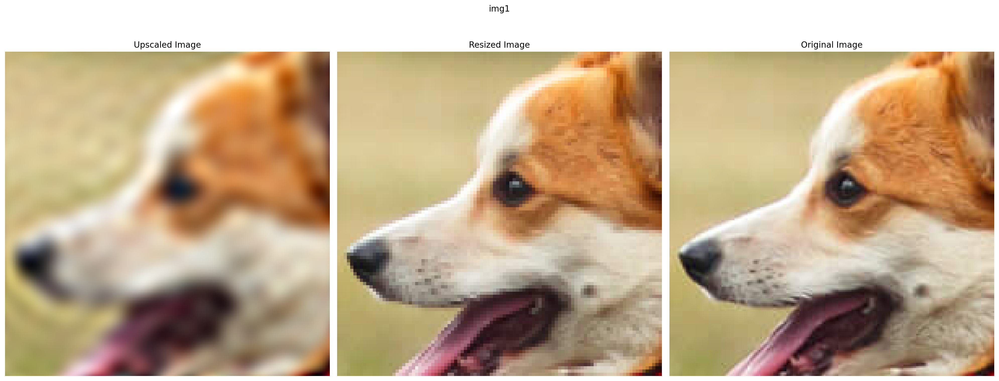

RMSE:  0.05324989929795265
PSNR:  25.473624422038025
************************************************************






Sigma =  0.115
img1 already exists
***********************Patience Brings Prosperity*****************************


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


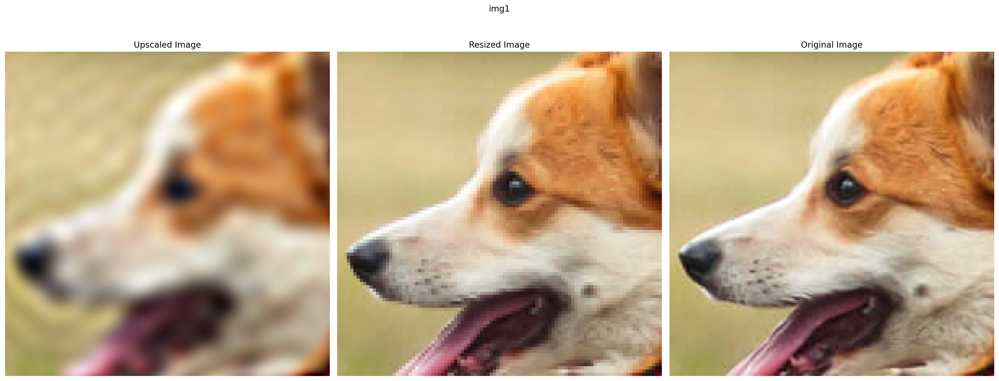

RMSE:  0.05471258983016014
PSNR:  25.238254581001218
************************************************************






Sigma =  0.12000000000000001
img1 already exists
***********************Patience Brings Prosperity*****************************


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


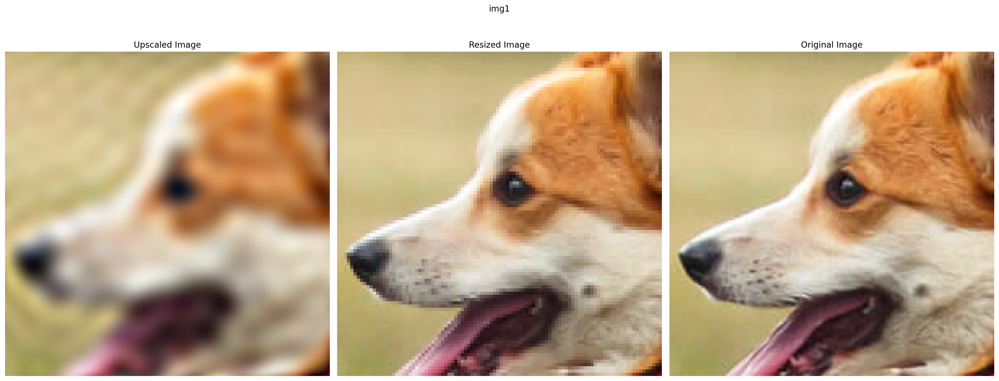

RMSE:  0.055893462151288986
PSNR:  25.052779804067875
************************************************************






Sigma =  0.125
img1 already exists
***********************Patience Brings Prosperity*****************************


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


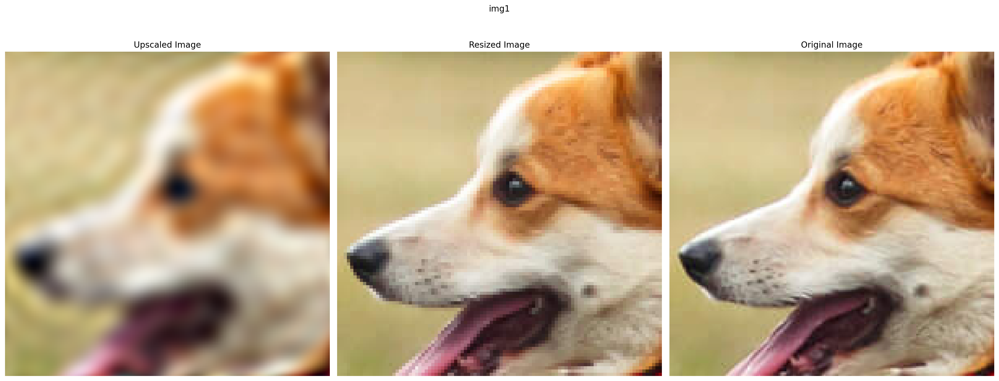

RMSE:  0.05721448361873627
PSNR:  24.849881068824438
************************************************************






Sigma =  0.13
img1 already exists
***********************Patience Brings Prosperity*****************************


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


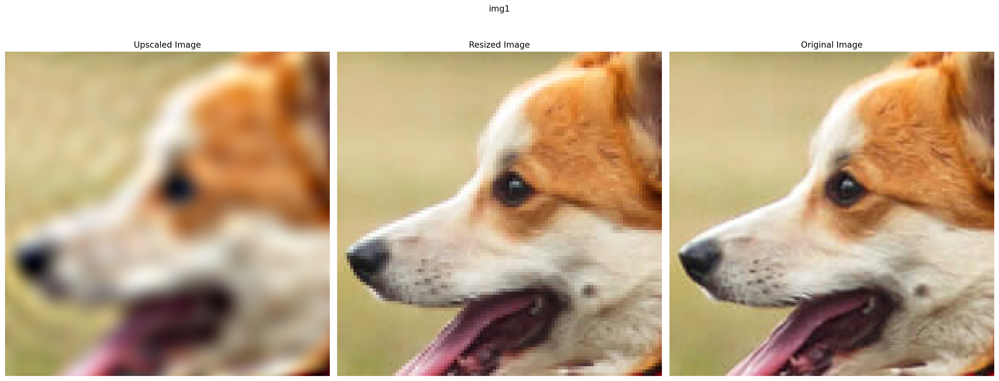

RMSE:  0.058386825025081635
PSNR:  24.673703496193756
************************************************************






Sigma =  0.135
img1 already exists
***********************Patience Brings Prosperity*****************************


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


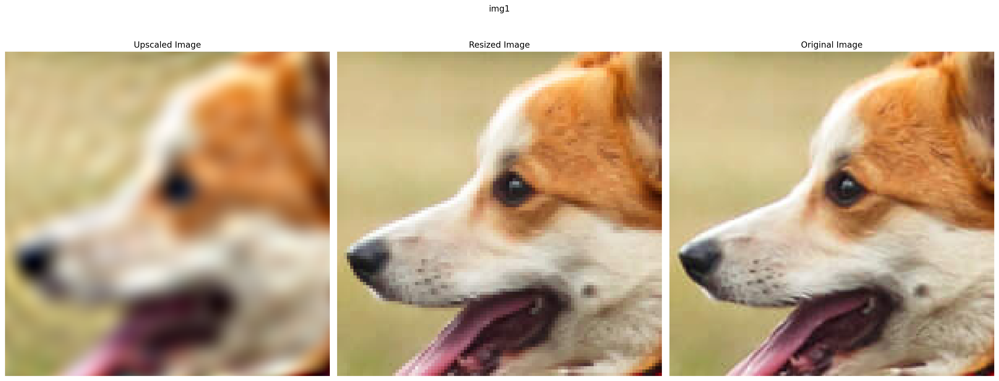

RMSE:  0.05926434323191643
PSNR:  24.544130510948126
************************************************************






Sigma =  0.14
img1 already exists
***********************Patience Brings Prosperity*****************************


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


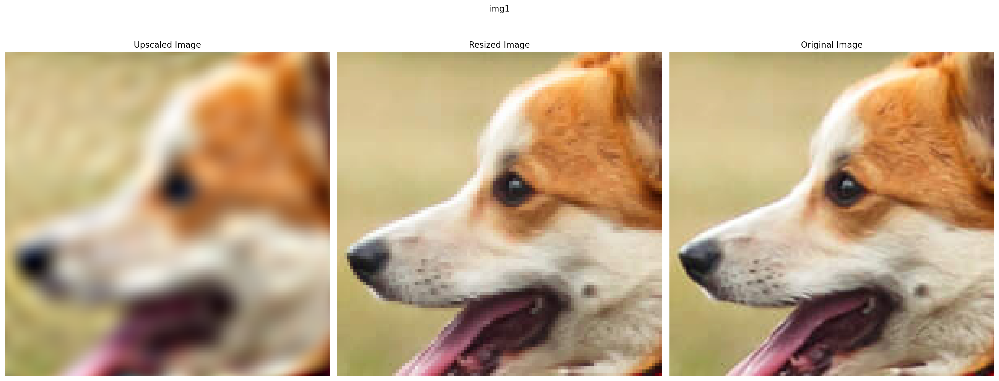

RMSE:  0.060120247304439545
PSNR:  24.419585398695197
************************************************************






Sigma =  0.14500000000000002
img1 already exists
***********************Patience Brings Prosperity*****************************


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


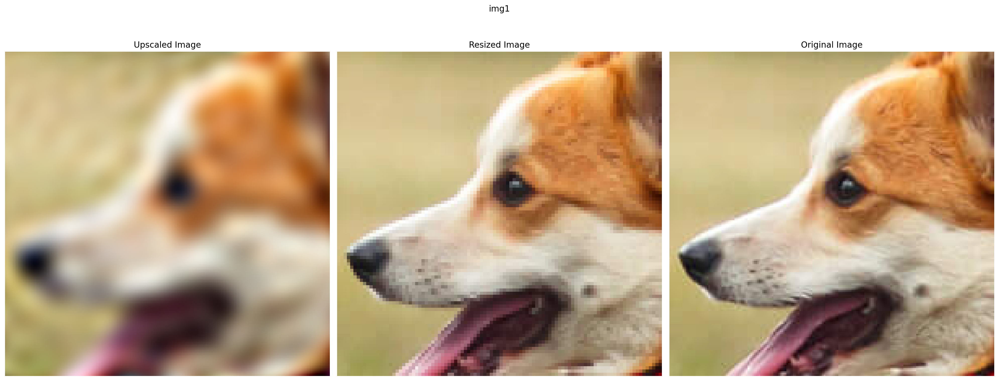

RMSE:  0.06112544238567352
PSNR:  24.275560031673496
************************************************************








In [43]:
rmse_vals = []
psnr_vals = []
sigma_vals = []
for i in np.arange(0.005,0.15,0.005):
    print("Sigma = ",i)
    output,rmse_val,psnr_val = upscale(url,"img1",LinearModel,scale, n_features=30000, sigma=i)
    rmse_vals.append(rmse_val)
    psnr_vals.append(psnr_val)
    sigma_vals.append(i)
    

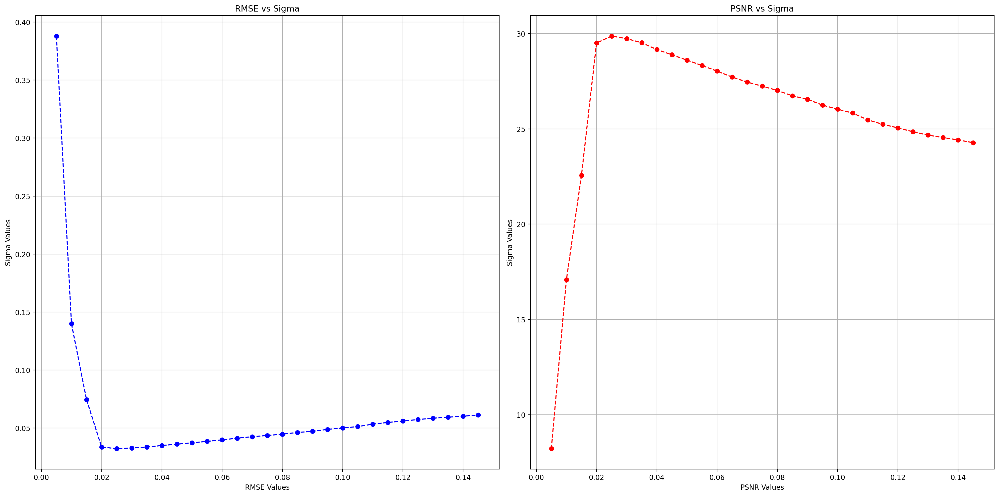

In [45]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))

ax1.plot(sigma_vals,rmse_vals, marker='o', linestyle='--', color='b')
ax1.set_title('RMSE vs Sigma')
ax1.set_xlabel('RMSE Values')
ax1.set_ylabel('Sigma Values')
ax1.grid(True)

ax2.plot(sigma_vals,psnr_vals, marker='o', linestyle='--', color='r')
ax2.set_title('PSNR vs Sigma')
ax2.set_xlabel('PSNR Values')
ax2.set_ylabel('Sigma Values')
ax2.grid(True)

plt.tight_layout()
plt.show()


img1 already exists
***********************Patience Brings Prosperity*****************************


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


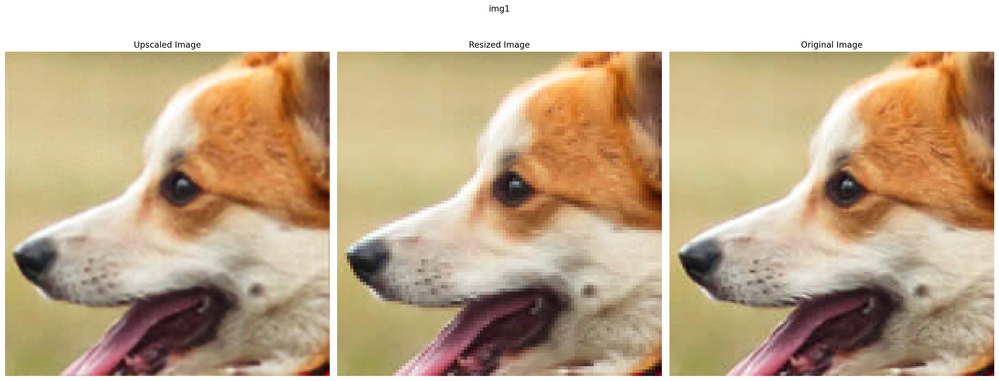

RMSE:  0.028606055304408073
PSNR:  30.870840925633402
************************************************************






using neural network


In [46]:
scale = 2
upscale(url,"img1",ComplexModel,scale,n_features = 30000,sigma = 0.02)
print("using neural network")

img1 already exists
***********************Patience Brings Prosperity*****************************


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


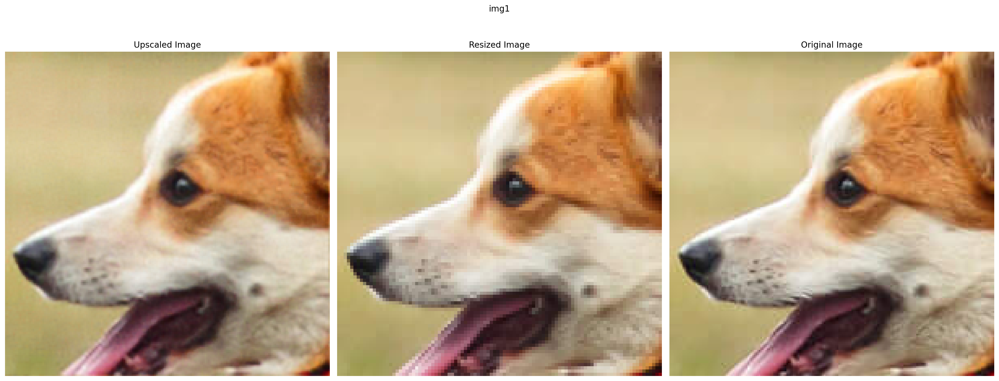

RMSE:  0.0288377795368433
PSNR:  30.80076436958307
************************************************************






using neural network


In [47]:
scale = 2
upscale(url,"img1",ComplexModel,scale,n_features = 3000,sigma = 0.02)
print("using neural network")

Using Linear Model
img4 downloaded


--2024-09-16 11:15:35--  https://images.unsplash.com/photo-1726090401458-7abb00f7450c
Resolving images.unsplash.com (images.unsplash.com)... 146.75.38.208, 2a04:4e42:78::720
Connecting to images.unsplash.com (images.unsplash.com)|146.75.38.208|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1236361 (1.2M) [image/jpeg]
Saving to: ‘img4’

     0K .......... .......... .......... .......... ..........  4% 21.4M 0s
    50K .......... .......... .......... .......... ..........  8% 51.4M 0s
   100K .......... .......... .......... .......... .......... 12% 72.9M 0s
   150K .......... .......... .......... .......... .......... 16%  111M 0s
   200K .......... .......... .......... .......... .......... 20%  113M 0s
   250K .......... .......... .......... .......... .......... 24%  112M 0s
   300K .......... .......... .......... .......... .......... 28% 91.4M 0s
   350K .......... .......... .......... .......... .......... 33%  108M 0s
   400K .......... ........

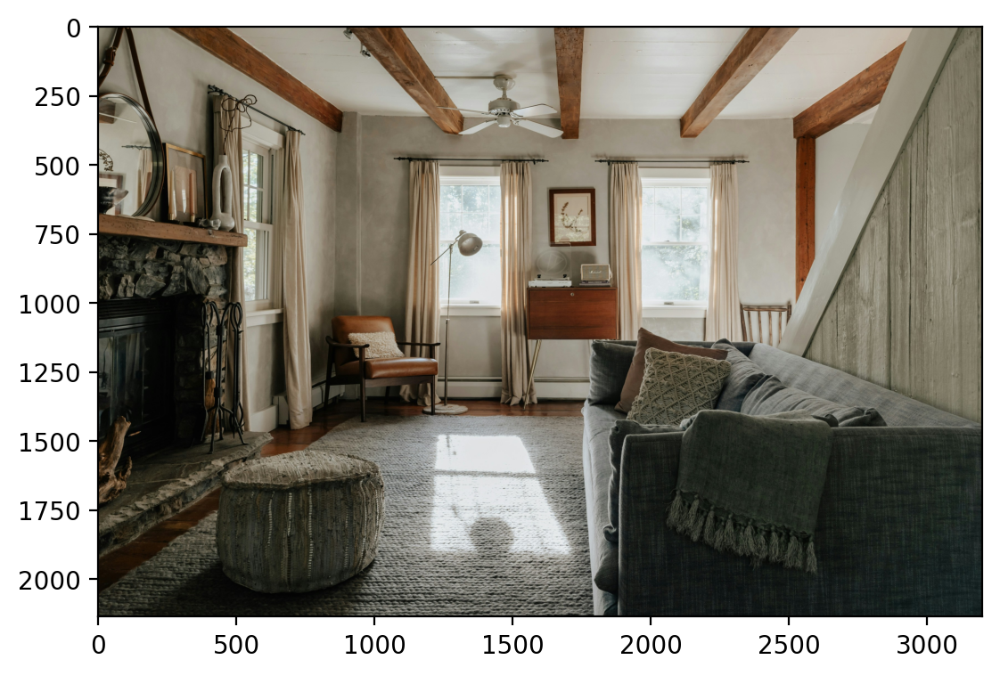

***********************Patience Brings Prosperity*****************************


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


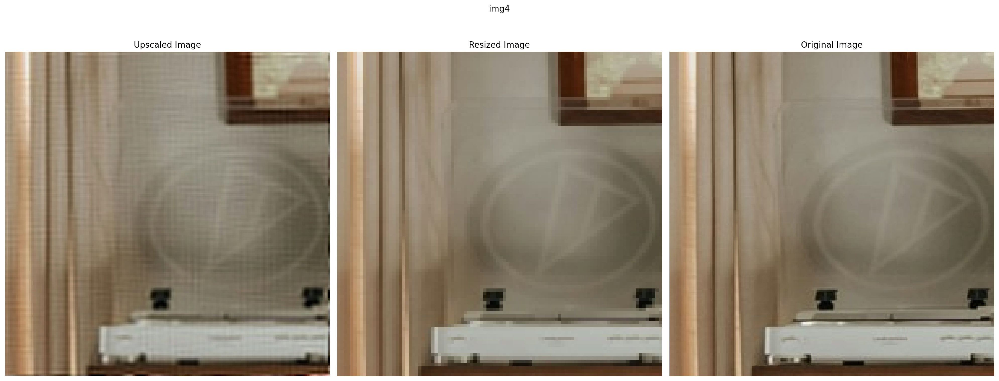

RMSE:  0.03877067193388939
PSNR:  28.229934144400293
************************************************************











Using Linear Model
img4 already exists


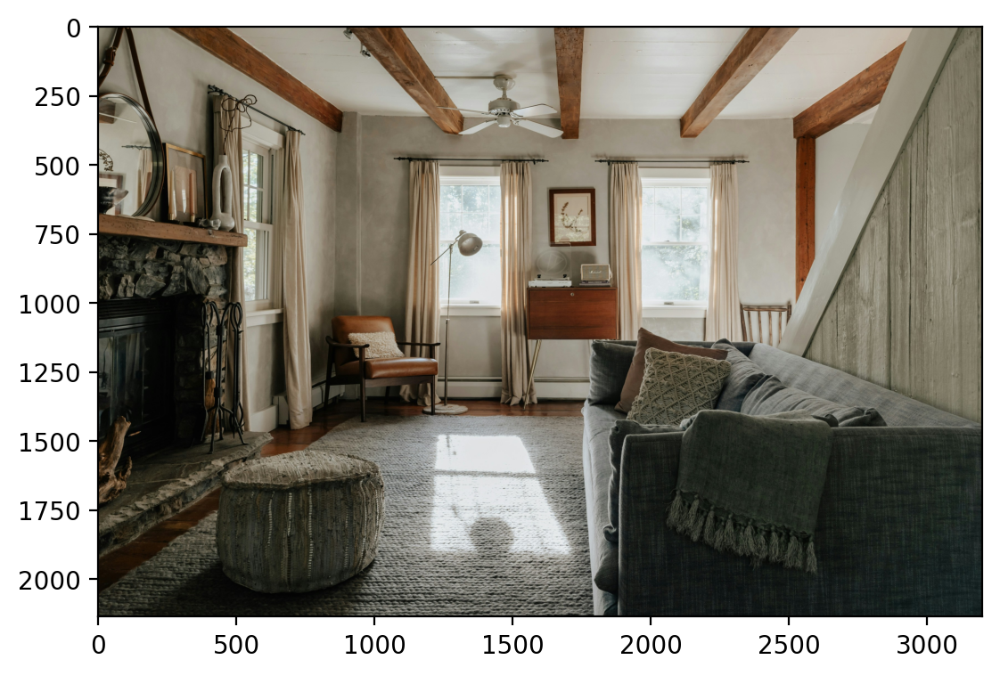

***********************Patience Brings Prosperity*****************************


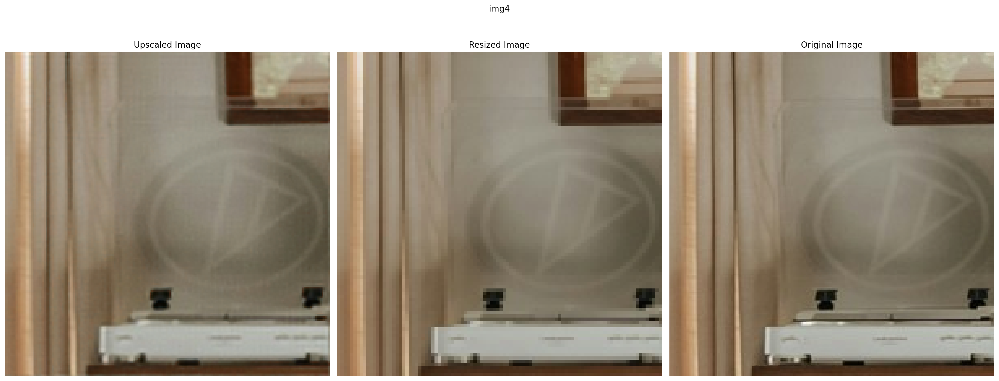

RMSE:  0.03332770988345146
PSNR:  29.543891262345614
************************************************************






****************************************************************************************************


In [48]:
scale = 2
url = "https://images.unsplash.com/photo-1726090401458-7abb00f7450c"
print("Using Linear Model")
upscale(url,"img4",LinearModel,scale,coords=[750,1500],showimg = True,n_features = 30000,sigma = 0.02)
print("\n\n\n\n")
print("Using Linear Model")
upscale(url,"img4",ComplexModel,scale,coords=[750,1500],showimg = True,n_features = 10000,sigma = 0.02)
print("*"*100)

In [49]:
print(sigma_vals)
print(rmse_vals)
print(psnr_vals)

[0.005, 0.01, 0.015, 0.02, 0.025, 0.030000000000000002, 0.034999999999999996, 0.04, 0.045, 0.049999999999999996, 0.055, 0.06, 0.065, 0.07, 0.07500000000000001, 0.08, 0.085, 0.09000000000000001, 0.095, 0.1, 0.10500000000000001, 0.11, 0.115, 0.12000000000000001, 0.125, 0.13, 0.135, 0.14, 0.14500000000000002]
[0.38800323009490967, 0.13989777863025665, 0.07445067167282104, 0.03347478434443474, 0.03211424872279167, 0.032613229006528854, 0.03343241289258003, 0.03481950983405113, 0.035952381789684296, 0.03712162375450134, 0.03835345804691315, 0.039677686989307404, 0.041128721088171005, 0.04239917919039726, 0.043455298990011215, 0.04458184912800789, 0.04606013745069504, 0.047036830335855484, 0.048717424273490906, 0.04993608966469765, 0.05110587179660797, 0.05324989929795265, 0.05471258983016014, 0.055893462151288986, 0.05721448361873627, 0.058386825025081635, 0.05926434323191643, 0.060120247304439545, 0.06112544238567352]
[8.22329431229473, 17.08378367543275, 22.562627442435556, 29.50564468080